In [1]:
# using Pkg
# Pkg.add("Images")
# Pkg.add("MAT")

using MAT
using Plots
using Images


pyplot()

file = matopen("project_data.mat")
img = read(file, "im")
sources = read(file,"sources")
rgb = read(file,"rgb")
close(file)

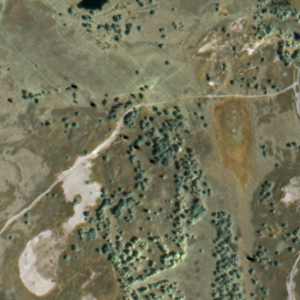

In [2]:
# visualize data in rgb (using bands 67,109,141 as th RGB channels)
p1 = colorview(RGB,permutedims(rgb,(3,1,2))) # convert 3d array to the image format used by julia

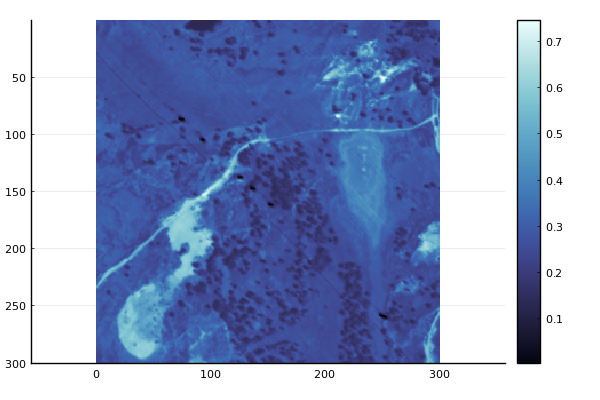

In [3]:
#visualize a spectral band on its own
p2 = heatmap(img[:,:,150],aspect_ratio=1, yflip = true,c=:ice)

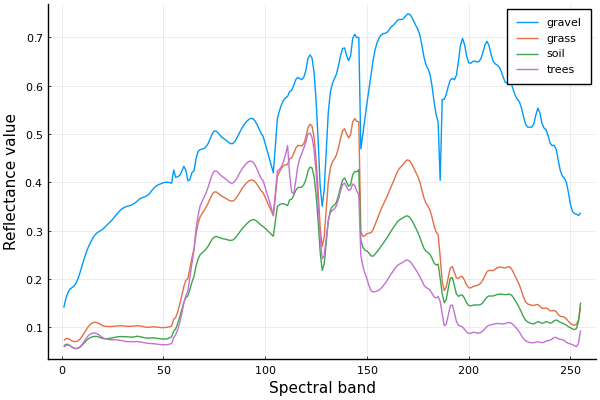

In [4]:
# visualize the endmembers to be used

plot(sources[:,1],label = "gravel")
plot!(sources[:,2],label = "grass")
plot!(sources[:,3],label = "soil")
plot!(sources[:,4],label = "trees")
xlabel!("Spectral band")
ylabel!("Reflectance value")

# Unmixing the image

The model we are using to decompose the image into the sum of the contributions of the endmembers is:

\begin{equation*}
\mathbf{X} = \mathbf{S}\mathbf{A} + \mathbf{E} 
\end{equation*}

 $\mathbf{X}\in \mathbb{R}^{L\times N}$ : data matrix
 
 $\mathbf{S}\in \mathbb{R}^{L\times P}$ : endmember matrix
 
 $\mathbf{A}\in \mathbb{R}^{P\times N}$ : abundance matrix
 
 $\mathbf{E}\in \mathbb{R}^{L\times N}$ : additive noise matrix
 
 where $L$ is the number of spectral bands, $P$ is the number of materials, and $N$ is the number of pixels
 
 The hyperspectral image is represented as a matrix with $N$ pixels, so the first thing to do is to reshape the image to a big matrix.

We can try and estimate the abundance matrix using a least squares formulation:

\begin{equation*}
\hat{A} = \underset{\mathbf{A}>\mathbf{0}, \mathbf{1}_{P}^T \mathbf{A} = \mathbf{1}_{N}^{T} }{\textrm{arg min}}\frac{1}{2}||\mathbf{X}-\mathbf{SA}||_{F}^{2} = \underset{\mathbf{A}>\mathbf{0}, \mathbf{1}_{P}^T \mathbf{A} = \mathbf{1}_{N}^{T} }{\textrm{arg min}}\frac{1}{2} \sum_{i=1}^{N} ||\mathbf{x}_{n}-\mathbf{S}\mathbf{a}_{n}||_{2}^{2}
\end{equation*}

where $\mathbf{1}_{.}$ is a vector of ones whose size is given in index 

Choose an algorithm to solve the optimization problem, and implement it both in a serial version and a version parallelized across the pixels.

In [5]:
img_small = img[1:100,1:100,:]; # use a small crop of the image first
# img_small = copy(img);

100×100×255 Array{Float64, 3}:
[:, :, 1] =
 0.0648938  0.0619904  0.0562472  …  0.0413699  0.0435952  0.0459476
 0.0617573  0.0615453  0.0594049     0.0402891  0.0403103  0.042366
 0.0609308  0.0648514  0.0584724     0.0363685  0.0406918  0.0498894
 0.0588539  0.0616725  0.0584724     0.0395898  0.0333591  0.0324054
 0.0494867  0.0520934  0.0542551     0.0404587  0.0439131  0.0340161
 0.0515848  0.0446124  0.0510126  …  0.0445276  0.0395898  0.0414123
 0.0482999  0.0484695  0.0480668     0.0443793  0.0390176  0.0412216
 0.050504   0.0504404  0.060952      0.0449727  0.040501   0.0363897
 0.0538948  0.0610791  0.0601254     0.0458628  0.0413911  0.0403951
 0.0587065  0.0621811  0.0619268     0.0443793  0.0444005  0.0473887
 ⋮                                ⋱                        
 0.0712092  0.0716966  0.0711244     0.0570949  0.0521358  0.0509066
 0.0706582  0.071845   0.0669071     0.0578578  0.0538312  0.0522206
 0.0742609  0.0777153  0.070531      0.0540855  0.058981   0.0603374
 